### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.svm import SVR

In [4]:
df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\nJoshualand, VA 01..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\nFPO AE 73316


In [5]:
df = df.iloc[:, :-1]
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


In [4]:
X = df.iloc[:, :-1]
y = df['Price']
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# TEST

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 4.28490000e+00
  7.73353316e+04 1.39577435e+09]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 3.69664000e+01
  1.85222684e+05 9.28070968e+08]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 1.86624000e+01
  1.66645180e+05 1.48805170e+09]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 4.32640000e+00
  7.89093642e+04 1.43923071e+09]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 1.60000000e+01
  1.35356341e+05 1.14508369e+09]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 4.21201000e+01
  2.18266677e+05 1.13105958e+09]]
(4000, 21)
y_pred (4000,)
Score: 0.9179046219530919
MAE: 81545.59417508579


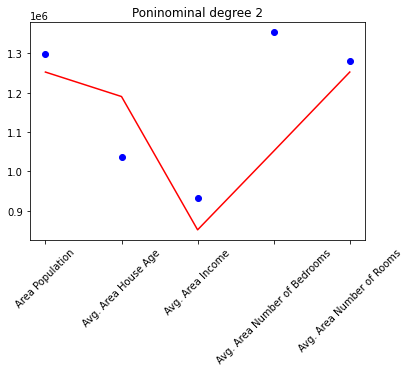

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 1.60084136e+05
  2.88925290e+09 5.21462184e+13]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 1.12615392e+06
  5.64267148e+09 2.82729927e+13]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 7.19907179e+05
  6.42838335e+09 5.74020009e+13]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 1.64131477e+05
  2.99359988e+09 5.46003752e+13]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 5.41425363e+05
  4.58033474e+09 3.87485844e+13]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 1.41655074e+06
  7.34057665e+09 3.80389238e+13]]
(4000, 56)
y_pred (4000,)
Score: 0.9126374414900709
MAE: 83700.3778188539


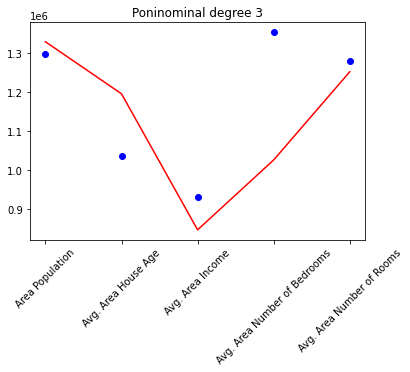

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 5.98075351e+09
  1.07942672e+14 1.94818603e+18]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 3.43074426e+10
  1.71899796e+14 8.61315721e+17]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 2.77706161e+10
  2.47976644e+14 2.21429787e+18]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 6.22668775e+09
  1.13568780e+14 2.07138504e+18]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 1.83213390e+10
  1.54994338e+14 1.31121665e+18]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 4.76403424e+10
  2.46872615e+14 1.27929576e+18]]
(4000, 126)
y_pred (4000,)
Score: 0.899515189842827
MAE: 88878.56517251946


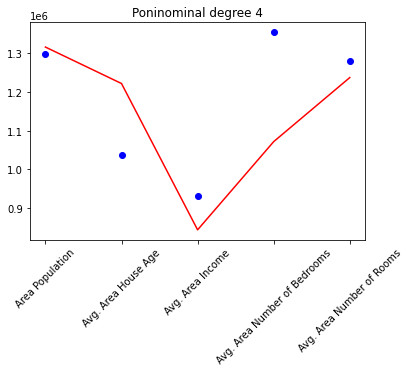

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 2.23441331e+14
  4.03274509e+18 7.27843540e+22]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 1.04515076e+15
  5.23679959e+18 2.62393437e+22]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 1.07125910e+15
  9.56576679e+18 8.54171452e+22]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 2.36223063e+14
  4.30848089e+18 7.85825368e+22]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 6.19977350e+14
  5.24486659e+18 4.43703719e+22]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 1.60220327e+15
  8.30262951e+18 4.30242890e+22]]
(4000, 252)
y_pred (4000,)
Score: 0.9017446901154106
MAE: 88705.03648897762


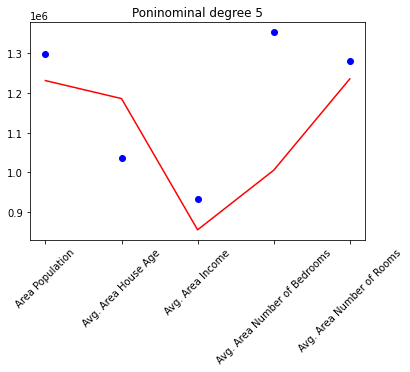

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 8.34778233e+18
  1.50663613e+23 2.71922809e+27]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 3.18397415e+19
  1.59535210e+23 7.99362115e+26]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 4.13241125e+19
  3.69002067e+23 3.29498971e+27]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 8.96164024e+18
  1.63451677e+23 2.98120097e+27]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 2.09794664e+19
  1.77481487e+23 1.50145279e+27]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 5.38840655e+19
  2.79227636e+23 1.44695972e+27]]
(4000, 462)
y_pred (4000,)
Score: 0.9087382544750765
MAE: 85430.68840288304


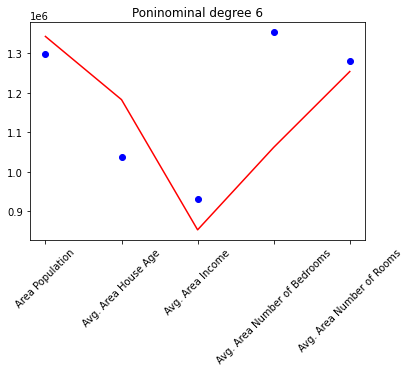

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 3.11873679e+23
  5.62880215e+27 1.01590534e+32]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 9.69974074e+23
  4.86012166e+27 2.43519731e+31]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 1.59408893e+24
  1.42343556e+28 1.27105128e+32]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 3.39979487e+23
  6.20089801e+27 1.13098400e+32]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 7.09925950e+23
  6.00581117e+27 5.08077890e+31]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 1.81218736e+24
  9.39076861e+27 4.86630341e+31]]
(4000, 792)
y_pred (4000,)
Score: 0.9021657383166913
MAE: 87793.30687386447


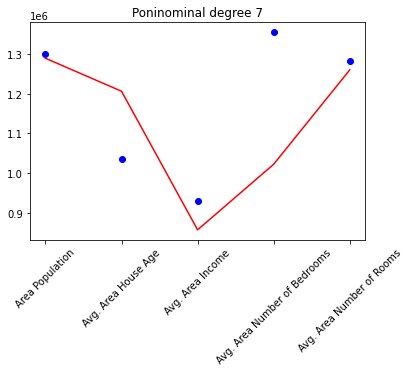

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 1.16516205e+28
  2.10292406e+32 3.79542882e+36]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 2.95495397e+28
  1.48059996e+32 7.41864772e+35]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 6.14924160e+28
  5.49094154e+32 4.90311505e+36]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 1.28978679e+28
  2.35244673e+32 4.29063599e+36]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 2.40232447e+28
  2.03231156e+32 1.71928910e+36]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 6.09460883e+28
  3.15823091e+32 1.63659765e+36]]
(4000, 1287)
y_pred (4000,)
Score: 0.8451765772902167
MAE: 106926.7404421472


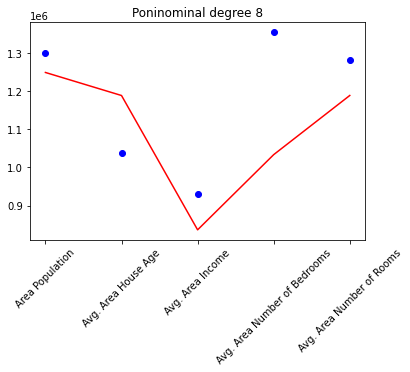

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 4.35305281e+32
  7.85653766e+36 1.41797462e+41]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 9.00204778e+32
  4.51053781e+36 2.26003592e+40]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 2.37208675e+33
  2.11814570e+37 1.89139003e+41]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 4.89308919e+32
  8.92452286e+36 1.62774691e+41]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 8.12924624e+32
  6.87715640e+36 5.81791703e+40]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 2.04969186e+33
  1.06215188e+37 5.50407907e+40]]
(4000, 2002)
y_pred (4000,)
Score: 0.6889407199521109
MAE: 141638.72797741377


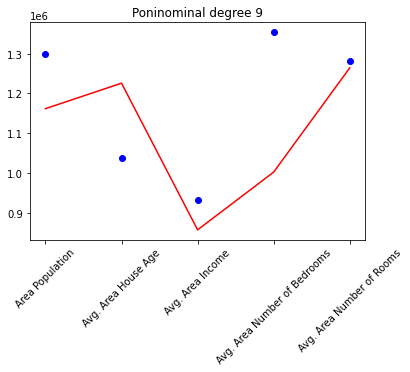

################
[[1.00000000e+00 5.58795038e+04 6.40794626e+00 ... 1.62630330e+37
  2.93520746e+41 5.29756219e+45]
 [1.00000000e+00 6.84193325e+04 5.86956274e+00 ... 2.74240699e+37
  1.37410184e+41 6.88503157e+44]
 [1.00000000e+00 6.33586059e+04 6.19484247e+00 ... 9.15038943e+37
  8.17080491e+41 7.29608870e+45]
 ...
 [1.00000000e+00 6.70471810e+04 6.44025247e+00 ... 1.85630075e+37
  3.38571358e+41 6.17521509e+45]
 [1.00000000e+00 8.27603763e+04 6.13569401e+00 ... 2.75086256e+37
  2.32716681e+41 1.96872990e+45]
 [1.00000000e+00 5.90076732e+04 5.88008112e+00 ... 6.89336568e+37
  3.57214732e+41 1.85108945e+45]]
(4000, 3003)
y_pred (4000,)
Score: 0.8629372579267867
MAE: 101100.30160794436


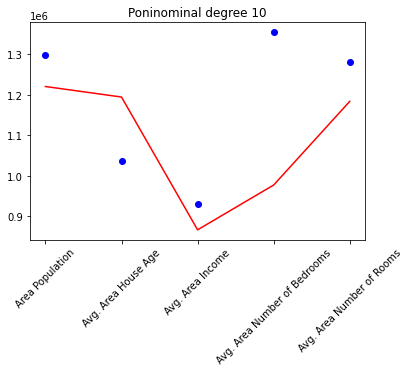

In [19]:
degree_min = 2
degree_max = 10

scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train, y_train)

    print(X_poly)
    print(X_poly.shape)

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.xticks(rotation=45)
    plt.show()
    input("Enter to next grade")

# SOLUTION

-----------------
POLINOMINAL DEGREE 2
              
              
Score: 0.41525119680430933
              


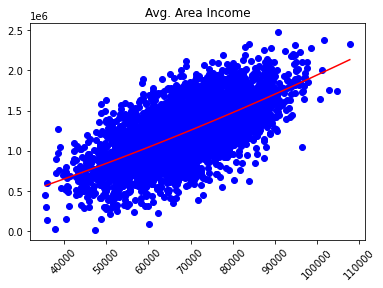

              
Score: 0.20774750219030524
              


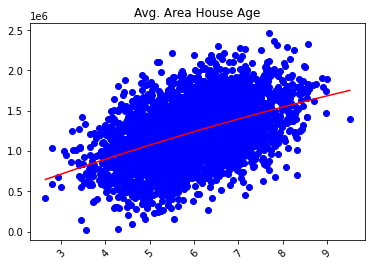

              
Score: 0.11583520269403125
              


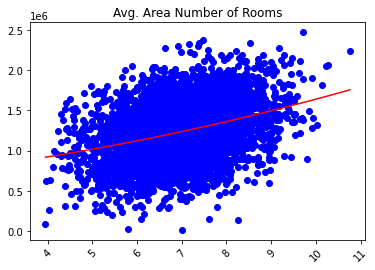

              
Score: 0.027535845786471502
              


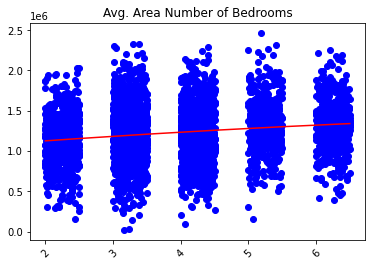

              
Score: 0.1666885645809173
              


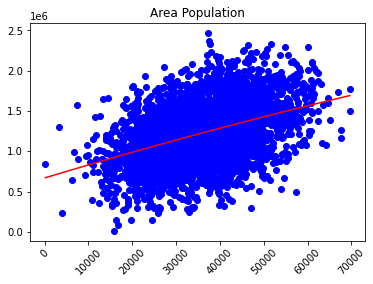

-----------------
POLINOMINAL DEGREE 3
              
              
Score: 0.40907292245711013
              


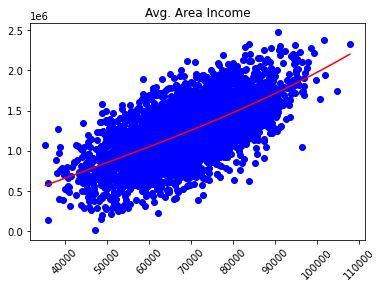

              
Score: 0.2124102157806047
              


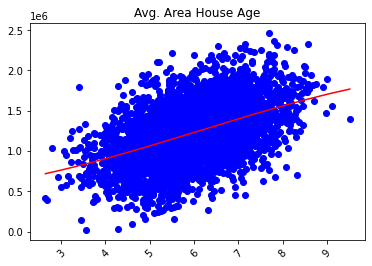

              
Score: 0.11451262112888672
              


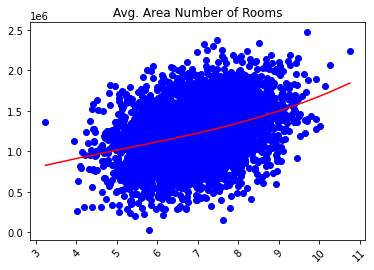

              
Score: 0.027633806784148396
              


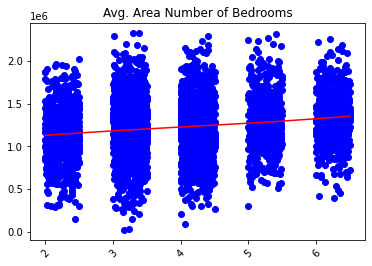

              
Score: 0.1687135755565734
              


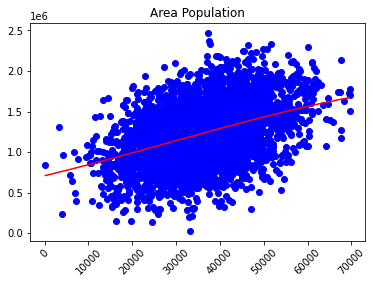

-----------------
POLINOMINAL DEGREE 4
              
              
Score: 0.4057117724763434
              


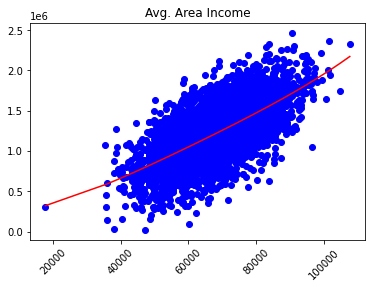

              
Score: 0.20196509180416744
              


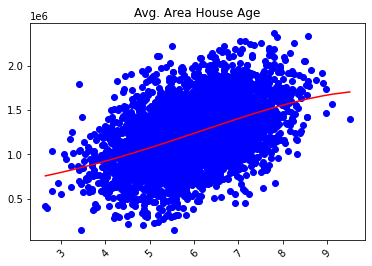

              
Score: 0.12393984647371936
              


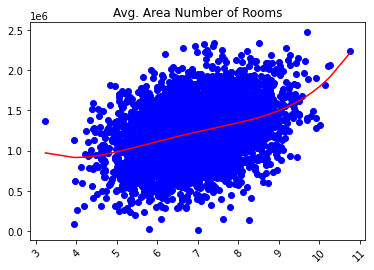

              
Score: 0.03781344210166948
              


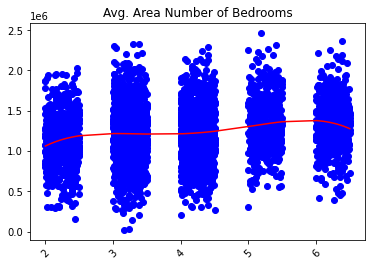

              
Score: 0.17107888443040142
              


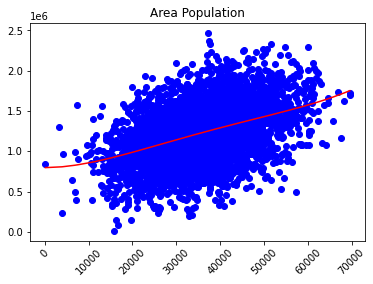

-----------------
POLINOMINAL DEGREE 5
              
              
Score: 0.40446281169129816
              


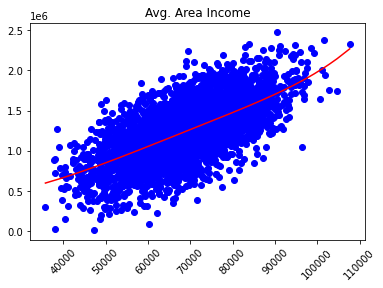

              
Score: 0.20172444535631429
              


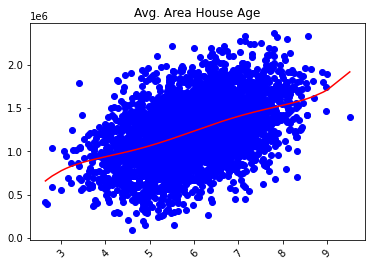

              
Score: 0.11565248556443064
              


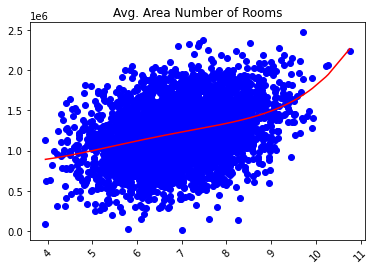

              
Score: 0.029645851801863188
              


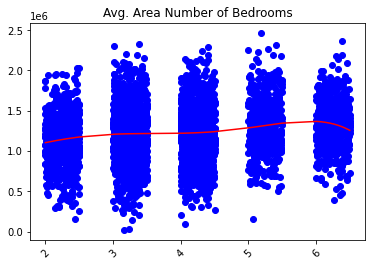

              
Score: 0.1688138057362324
              


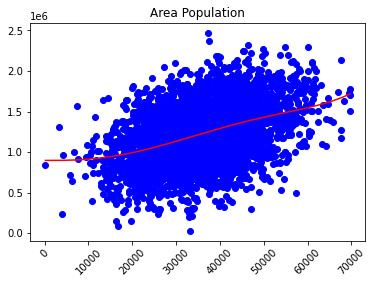

-----------------
POLINOMINAL DEGREE 6
              
              
Score: 0.4055944135901872
              


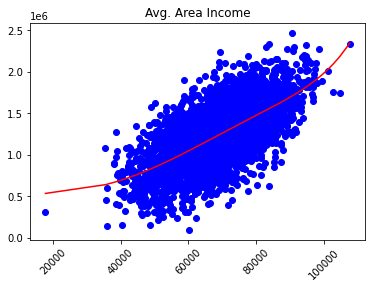

              
Score: 0.2021737646257049
              


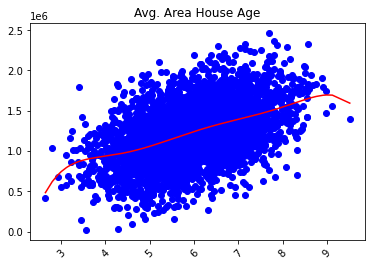

              
Score: 0.11795809242985988
              


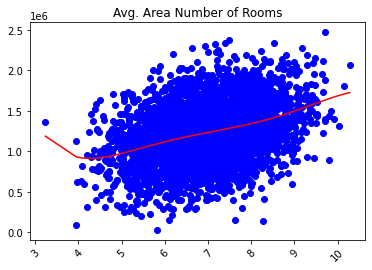

              
Score: 0.036597531214262013
              


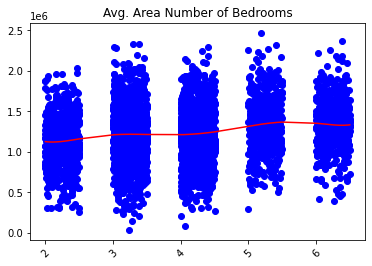

              
Score: 0.1689600385928931
              


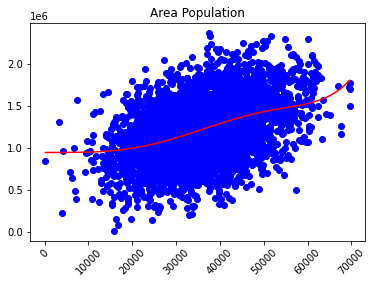

-----------------
POLINOMINAL DEGREE 7
              
              
Score: 0.4144087649369498
              


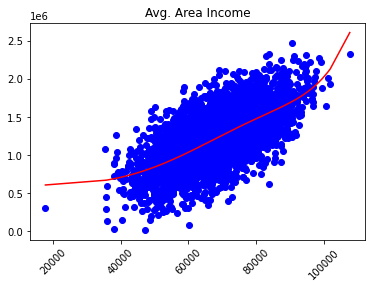

              
Score: 0.21068323228590113
              


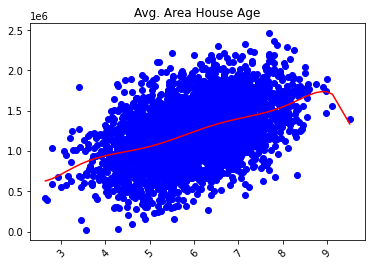

              
Score: 0.11793225491157189
              


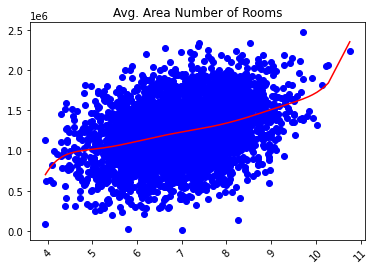

              
Score: 0.035003447877884675
              


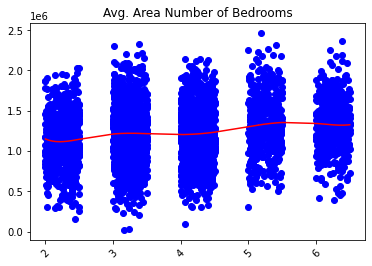

              
Score: 0.1665590118238267
              


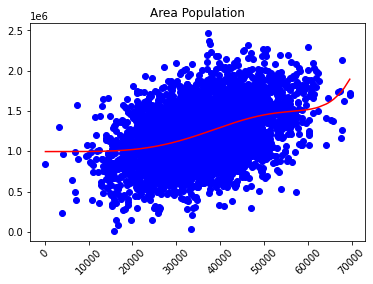

-----------------
POLINOMINAL DEGREE 8
              
              
Score: 0.39948335634567356
              


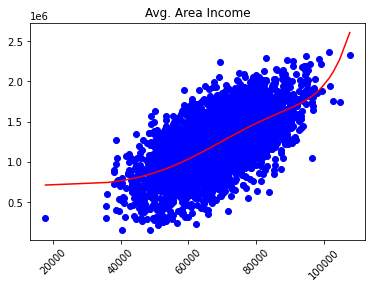

              
Score: 0.20284027464296006
              


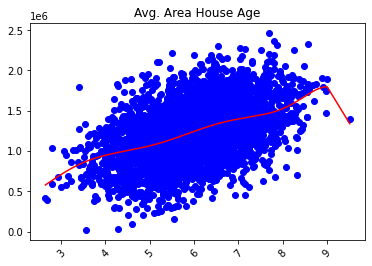

              
Score: 0.11657383120212539
              


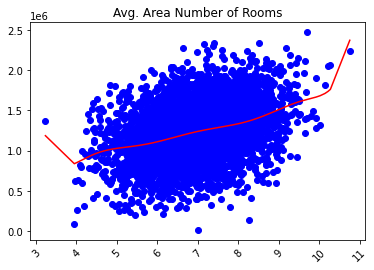

              
Score: 0.037609617386477945
              


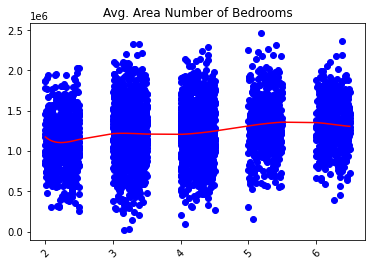

              
Score: 0.16036700648952984
              


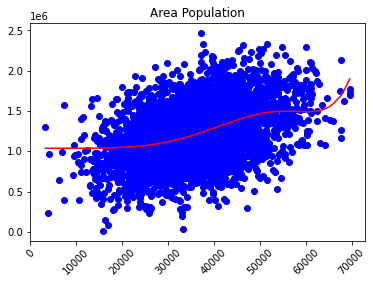

-----------------
POLINOMINAL DEGREE 9
              
              
Score: 0.41136050730179463
              


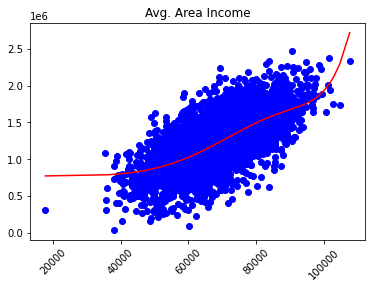

              
Score: 0.20675202117625135
              


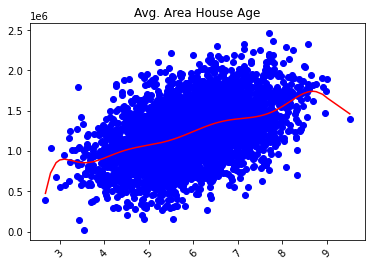

              
Score: 0.10911867512499407
              


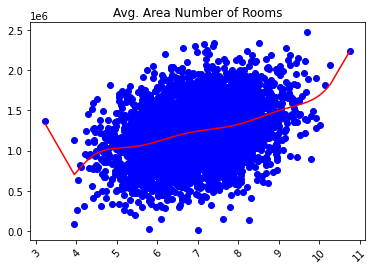

              
Score: 0.03339623268854641
              


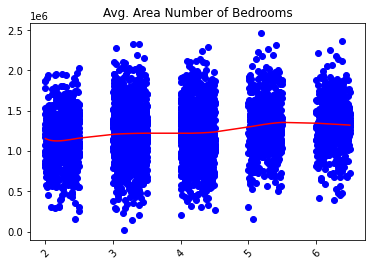

              
Score: 0.15302971169390756
              


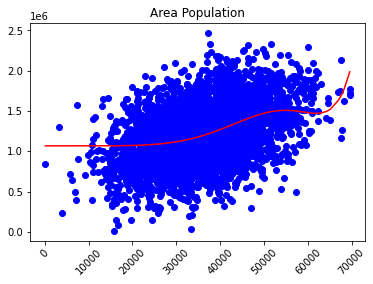

-----------------
POLINOMINAL DEGREE 10
              
              
Score: 0.3964142837846881
              


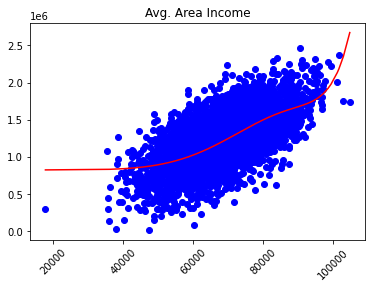

              
Score: 0.21514045059757392
              


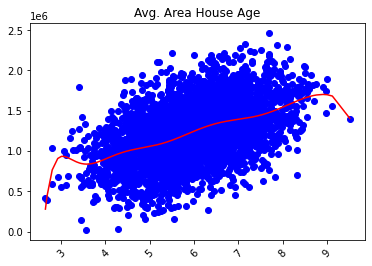

              
Score: 0.11807687218626595
              


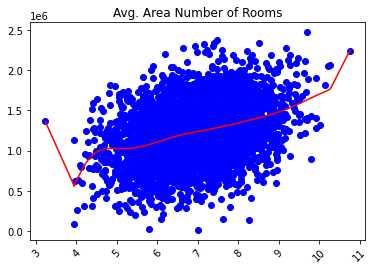

              
Score: 0.03214907138905265
              


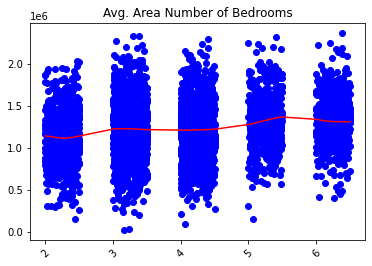

              
Score: 0.1468919702559659
              


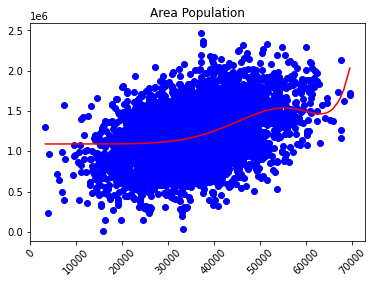

In [17]:
degree_min = 2
degree_max = 10
y = df['Price'].to_numpy()
a = degree_min

scores = []
for degree in range(degree_min,degree_max+1):
    print('-----------------')
    print('POLINOMINAL DEGREE', a)
    print('              ')
    polinominal_model = PolynomialFeatures(degree) 
    for i in range(len(df.columns)-1):
        X = df[[df.columns[i]]].to_numpy()

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1), y_train)

        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)
        print('              ')
        print("Score:", r2_score(y_train, y_pred))
        print('              ')
        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        plt.title(df.columns[i])
        plt.xticks(rotation=45)
        plt.show()
    if a < degree_max:
        a = int(input("Enter to next grade"))

### I DON'T THINK THERE´S A POINT AT WHICH THE SCORE STAGNATES, BUT IT IS SIMILAR FOR EACH COLUMN WITH DIFFERENT POLYNOMIAL DEGREE.

# SVR

In [9]:
y = df['Price'].to_numpy()
X = df[['Avg. Area Income']].to_numpy()
X.shape

(5000, 1)

In [7]:
y.shape

(5000,)

In [4]:
y = df['Price'].to_numpy()
X = df[['Avg. Area Income']].to_numpy()
    
svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)

lw = 2

svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    model = svr.fit(X, y)
    y_prediction = model.predict(X)
    axes[ix].plot(X, y_prediction, color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
    axes[ix].scatter(X[svr.support_], y[svr.support_], facecolor="none",
                     edgecolor=model_color[ix], s=50,
                     label='{} support vectors'.format(kernel_label[ix]))
    axes[ix].scatter(X[np.setdiff1d(np.arange(len(X)), svr.support_)],
                     y[np.setdiff1d(np.arange(len(X)), svr.support_)],
                     facecolor="none", edgecolor="k", s=50,
                     label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)

fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()

### I CAN'T GET THIS CODE TO RUN, I WOULD LIKE TO CHANGE THE X TO THE FOLLOWING FOR TO RUN THE CODE FOR ALL THE NUMERIC COLUMNS IN THE DATASET

In [ ]:
for i in range(len(df.columns)-1):
    X = df[[df.columns[i]]].to_numpy()

### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendrás una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM (SVC) para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

-------------------------- 

ACLARACIÓN del apartado 2 del ejercicio 2:

- El punto 3, se espera que tu X sea una sola columna e y también, 'Avg. Area Number of Bedrooms'.

- El punto 4, espera que tu X sean todas las columnas que cumplen con las características especificadas e y la columna 'Avg. Area Number of Bedrooms'

In [5]:
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


In [6]:
a = df['Avg. Area Number of Bedrooms'].unique()
a.sort()
a

array([2.  , 2.01, 2.02, 2.03, 2.04, 2.05, 2.06, 2.07, 2.08, 2.09, 2.1 ,
       2.11, 2.12, 2.13, 2.14, 2.15, 2.16, 2.17, 2.18, 2.19, 2.2 , 2.21,
       2.22, 2.23, 2.24, 2.25, 2.26, 2.27, 2.28, 2.29, 2.3 , 2.31, 2.32,
       2.33, 2.34, 2.35, 2.36, 2.37, 2.38, 2.39, 2.4 , 2.41, 2.42, 2.43,
       2.44, 2.45, 2.46, 2.47, 2.48, 2.49, 2.5 , 3.  , 3.01, 3.02, 3.03,
       3.04, 3.05, 3.06, 3.07, 3.08, 3.09, 3.1 , 3.11, 3.12, 3.13, 3.14,
       3.15, 3.16, 3.17, 3.18, 3.19, 3.2 , 3.21, 3.22, 3.23, 3.24, 3.25,
       3.26, 3.27, 3.28, 3.29, 3.3 , 3.31, 3.32, 3.33, 3.34, 3.35, 3.36,
       3.37, 3.38, 3.39, 3.4 , 3.41, 3.42, 3.43, 3.44, 3.45, 3.46, 3.47,
       3.48, 3.49, 3.5 , 4.  , 4.01, 4.02, 4.03, 4.04, 4.05, 4.06, 4.07,
       4.08, 4.09, 4.1 , 4.11, 4.12, 4.13, 4.14, 4.15, 4.16, 4.17, 4.18,
       4.19, 4.2 , 4.21, 4.22, 4.23, 4.24, 4.25, 4.26, 4.27, 4.28, 4.29,
       4.3 , 4.31, 4.32, 4.33, 4.34, 4.35, 4.36, 4.37, 4.38, 4.39, 4.4 ,
       4.41, 4.42, 4.43, 4.44, 4.45, 4.46, 4.47, 4.

WE CHECK THAT ALL NUMBERS IN THE COLUMN IN QUESTION GO FROM 0.5 TO THE NEXT INTEGER, AS 2,5 --> 3

# 1

In [7]:
df["Avg. Area Number of Bedrooms"] = [float(round(val)) for val in df["Avg. Area Number of Bedrooms"]]
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.0,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.0,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.0,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.0,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.0,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.0,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.0,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.0,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.0,42625.620156,1.198657e+06


In [8]:
a = df['Avg. Area Number of Bedrooms'].unique()
a.sort()
a

array([2., 3., 4., 5., 6.])

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 6 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
dtypes: float64(6)
memory usage: 234.5 KB


Usando las demás columnas numéricas y una a una, utiliza SVM (SVC) para clasificar esa columna modificada.

El punto 3, se espera que tu X sea una sola columna e y también, 'Avg. Area Number of Bedrooms'

In [1]:
import scipy.io as sio
from plot_data import plot_data
from sklearn import svm
from visualize_boundary_linear import visualize_boundary_linear

In [10]:
X = df['Avg. Area Income']
y = df['Avg. Area Number of Bedrooms'].ravel()

# Plot training data
plt.figure()
plot_data(X, y)
plt.show()

KeyError: 'key of type tuple not found and not a MultiIndex'

DOESN´T MAKE SENSE

In [24]:
X.shape

(5000,)

In [19]:
y.shape

(5000,)

In [19]:
C = 1
clf = svm.LinearSVC(C=C)
clf.fit(X, y)
print ('score:', clf.score(X, y))

plt.figure()
visualize_boundary_linear(X, y, clf)
plt.xlim([0, 4.5])
plt.ylim([1.5, 5])  
plt.title("Dataset 1")
plt.show()

score: 0.2964


TypeError: '((array([], dtype=int64),), 0)' is an invalid key